In [7]:
import pandas as pd
import numpy as np
from astropy.coordinates import SkyCoord
import astropy.units as units
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import Image, display

In [2]:
TESS = pd.read_csv('tessqueries.csv')
VLT = pd.read_csv('vltqueries.csv')
ALMA = pd.read_csv('almaqueries.csv')
JWST = pd.read_csv('jwstqueries.csv')

In [ ]:
display(TESS.head())
display(VLT.head())
display(ALMA.head())
display(JWST.head())

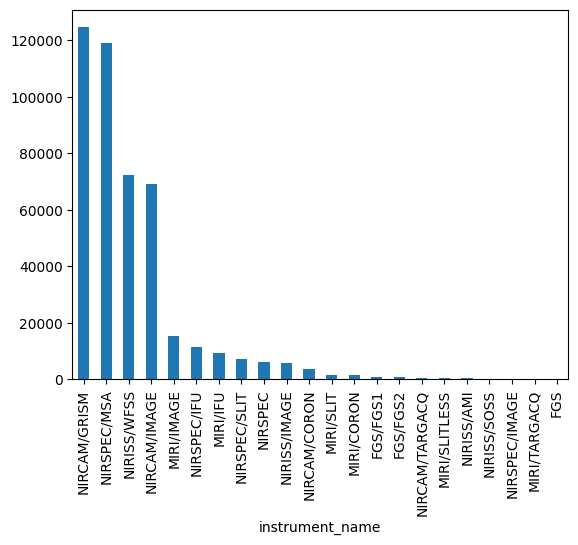

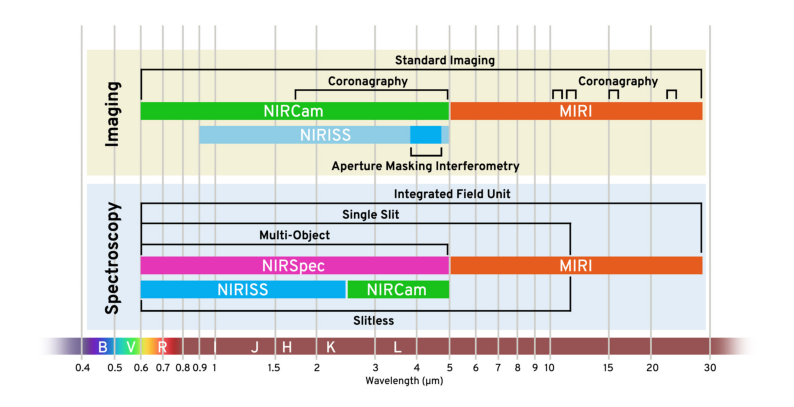

In [12]:
JWST_insts = JWST.instrument_name.value_counts()
JWST_insts.plot.bar()
plt.figure(figsize=(10, 6))
plt.imshow(plt.imread('image.jpeg'))
plt.axis('off')
plt.show()

In [26]:
valid_data.target_classification.unique()

array(['Calibration; Spectrophotometric', 'Galaxy; Quasars',
       'Clusters of Galaxies; Abell clusters',
       'Clusters of Galaxies; Abell clusters; Rich clusters',
       'Galaxy; High-redshift galaxies; Quasars',
       'ISM; Photodissociation regions; Reflection nebulae',
       'Calibration; External flat field', 'Galaxy; Field galaxies',
       'Star; B stars', 'Clusters of Galaxies; Rich clusters',
       'Star; Type Ia supernovae', 'Solar System; Asteroid',
       'Unidentified; Blank field',
       'Unidentified; Blank field; Parallel field',
       'Calibration; Stray light test', 'Galaxy; Spiral arms',
       'Star; M dwarfs', 'Star; Protostars',
       'Unidentified; High Latitude Field',
       'Unidentified; Infrared sources',
       'Calibration; Pointing and jitter test',
       'Calibration; Planetary nebulae',
       'ISM; Dark interstellar clouds; Dense interstellar clouds',
       'Unidentified; Infrared sources; Radio sources; Variable radiation sources; Visibl

C:\Users\Moreno\AppData\Local\Temp\ipykernel_15656\2621700530.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid_data['target_classification'] = valid_data['target_classification'].str.split(',').str[0]
C:\Users\Moreno\AppData\Local\Temp\ipykernel_15656\2621700530.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid_data['target_classification'] = valid_data['target_classification'].str.split(';').str[0]
C:\Users\Moreno\AppData\Local\Temp\ipykernel_15656\2621700530.py:15: FutureWarning: 

Pass

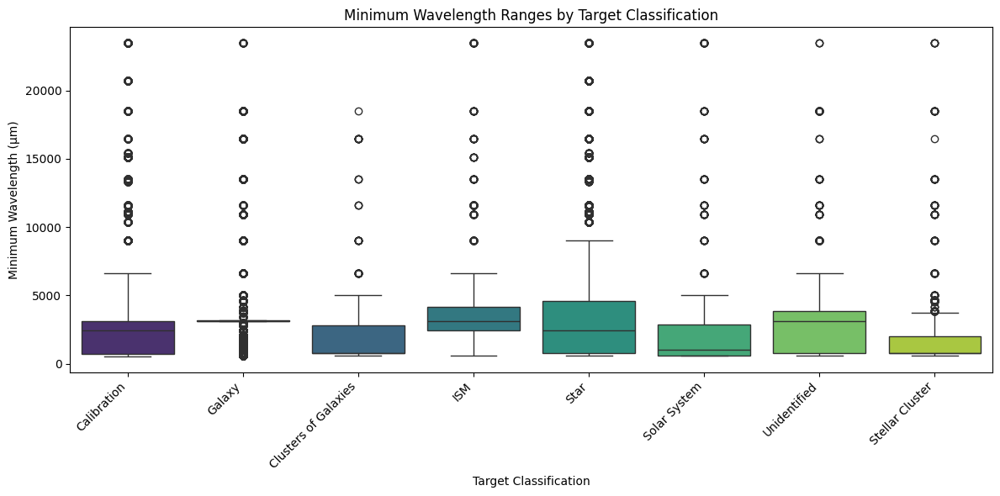


Wavelength Range Statistics by Target Classification:
                        em_min                   em_max                
                          mean    min      max     mean    min      max
target_classification                                                  
Calibration            2524.73  500.0  23500.0  4281.80  781.0  27900.0
Clusters of Galaxies   1594.25  600.0  18500.0  2741.28  781.0  23500.0
Galaxy                 3376.90  600.0  23500.0  4565.65  781.0  27500.0
ISM                    3548.66  600.0  23500.0  4406.39  781.0  27500.0
Solar System           2555.46  600.0  23500.0  5609.77  781.0  27500.0
Star                   3900.00  600.0  23500.0  5988.18  781.0  27900.0
Stellar Cluster        1853.14  600.0  23500.0  3319.95  781.0  27500.0
Unidentified           2675.27  600.0  23500.0  3941.61  781.0  27500.0


In [28]:
JWST.target_classification.unique()
JWST.em_min.unique()

# Create a box plot to show the wavelength ranges for different target classifications
plt.figure(figsize=(12, 6))

# Filter out any rows with NaN values in the required columns
valid_data = JWST.dropna(subset=['target_classification', 'em_min', 'em_max'])

# Extract first word from target_classification
valid_data['target_classification'] = valid_data['target_classification'].str.split(',').str[0]
valid_data['target_classification'] = valid_data['target_classification'].str.split(';').str[0]

# Create box plot
sns.boxplot(data=valid_data, 
            x='target_classification',
            y='em_min',
            palette='viridis')

plt.xticks(rotation=45, ha='right')
plt.title('Minimum Wavelength Ranges by Target Classification')
plt.xlabel('Target Classification')
plt.ylabel('Minimum Wavelength (μm)')
plt.tight_layout()
plt.show()

# Print some basic statistics
print("\nWavelength Range Statistics by Target Classification:")
stats = valid_data.groupby('target_classification').agg({
    'em_min': ['mean', 'min', 'max'],
    'em_max': ['mean', 'min', 'max']
}).round(2)
print(stats)



In [64]:
# Create a combined dataframe for sky plot
# Standardize RA and DEC column names and add an 'Observatory' column
tess_sky = TESS[['s_ra', 's_dec', 'target_name']].copy()
tess_sky.rename(columns={'s_ra': 'RA', 's_dec': 'DEC', 'target_name': 'Target'}, inplace=True)
tess_sky['Observatory'] = 'TESS'

# VLT already has 'RA' and 'DEC'
vlt_sky = VLT[['RA', 'DEC', 'OBJECT']].copy()
vlt_sky.rename(columns={'OBJECT': 'Target'}, inplace=True)
vlt_sky['Observatory'] = 'VLT'

alma_sky = ALMA[['s_ra', 's_dec', 'target_name']].copy()
alma_sky.rename(columns={'s_ra': 'RA', 's_dec': 'DEC', 'target_name': 'Target'}, inplace=True)
alma_sky['Observatory'] = 'ALMA'

jwst_sky = JWST[['s_ra', 's_dec', 'target_name']].copy()
jwst_sky.rename(columns={'s_ra': 'RA', 's_dec': 'DEC', 'target_name': 'Target'}, inplace=True)
jwst_sky['Observatory'] = 'JWST'

combined_sky_df = pd.concat([tess_sky, vlt_sky, alma_sky, jwst_sky], ignore_index=True)

# Drop rows with NaN RA/DEC values
combined_sky_df.dropna(subset=['RA', 'DEC'], inplace=True)

# Create the interactive scatter plot
fig_sky = px.scatter(
    combined_sky_df,
    x='RA',
    y='DEC',
    color='Observatory',
    hover_data=['Target', 'Observatory'],
    title='Sky Coverage by Observatory (Interactive)',
    labels={'RA': 'Right Ascension (degrees)', 'DEC': 'Declination (degrees)'},
    color_discrete_map={'TESS': 'yellow', 'VLT': 'blue', 'ALMA': 'green', 'JWST': 'red'}
)

fig_sky.update_layout(
    xaxis_title='Right Ascension (degrees)',
    yaxis_title='Declination (degrees)',
    xaxis=dict(range=[0,360]), # RA typically 0-360
    yaxis=dict(range=[-90,90])  # DEC is -90 to 90
)
fig_sky.update_layout(width=1500)  # Reduce width from default
fig_sky.show()

As mentioned in our report, this view shows how spread out TESS's observations are, with a big focus on the Large Magellanic Cloud and the astral bodies around the North Galactic Pole
In contrast, JWST is much more all over the place, but we can see some denser clusters which are constellations (for instance, the big middle one is Virgo, and to the left we have Taurus and Auriga)
Curiously enough, the main focus of VLT and ALMA (Proxima Centauri) is in the Centaurus constellation, which neither of the other two observatories seems to have observed much of.

In [58]:
TESS[['t_min', 't_max', 't_exptime']]
TESS.

array([ 158.399926,  158.399927, 1425.599406, 1425.59939 , 1425.599393,
       1425.599383,  158.399924, 1425.599365, 1425.599392, 1425.599379,
       1425.599358, 1425.599381,  158.399928, 1425.599399, 1425.599351,
       1425.599348, 1425.599402,  475.199782,  475.199791,  475.199793,
        475.199788,  475.19979 ,  475.199789,  475.199787, 1425.599428,
       1425.599438, 1425.599424, 1425.599419, 1425.599416,  475.199784,
       1425.59941 ,  158.39993 ,  475.199767, 1425.599414,  475.199778,
       1425.599391, 1425.599394,  475.199783,  158.399923,  475.199781,
        475.199775,  475.199786,  158.399925,  158.399929])